# Market Basket Analysis Project

### Business Purpose and Objectives

In this notebook we invesitage the Instacart grocery purchase dataset and apply a Market Basket Analysis 



#### The key objectives are to:
* Understand customers purchases and pattens 
* Answer questions and find inights to to improve purchasing experience
* Improve product placement and recommend potential for upsell

#### Business Questions of interest:
* Which are the most purpolar items purchased ? Which are the least ?
* What does the distrubution of the products purchased look like ?
* Do customers purchase items together frequently and which products are most often purchased together ?
* Can we use this information to recommend other products based on a customer’s cart ?

### Instacart Dataset Information

“The Instacart Online Grocery Shopping Dataset 2017”, Accessed from https://www.instacart.com/datasets/grocery-shopping-2017 on 1/13/2021 <br>
If you have questions about this dataset, you can reach out to us directly at open.data@instacart.com.

### Import Python Libraries

In [1]:
import pandas as pd
import seaborn as sns
import plotly.io as pio
from pandas_profiling import ProfileReport
from pandas_profiling.utils.cache import cache_file
from matplotlib import pyplot as plt

## Key Business Questions And Insights

* Which are the most popular items purchased ? Which are the least ?
* What does the overall distribution of the products purchased look like ?
* What does the distribution of customer orders look like ?
* Do customers purchase items together frequently and which products are most often purchased together ?
* Can we use this information to recommend other products based on a customer’s cart ?

#### Load prepared dataset 

In [3]:
orders_combined_df = pd.read_pickle("data/orders_combined.pkl")

### Which are the most popular items purchased (purchased most frequently)? 

* By far, bananas are the most popular product purchased, followed bu Strawberries and Spinach
* A Majority of the top 20 products are organic - it seems that Instacart customers like fresh and healthy products
* This is confirmed by looking at the most popular aisles with the top two: fresh vegetables and fresh fruits 

In [4]:
# Identify top products by count
product_count = orders_combined_df['product_name'].value_counts()
product_count.head(20)

Banana                    18726
Bag of Organic Bananas    15480
Organic Strawberries      10894
Organic Baby Spinach       9784
Large Lemon                8135
Organic Avocado            7409
Organic Hass Avocado       7293
Strawberries               6494
Limes                      6033
Organic Raspberries        5546
Organic Blueberries        4966
Organic Whole Milk         4908
Organic Cucumber           4613
Organic Zucchini           4589
Organic Yellow Onion       4290
Organic Garlic             4158
Seedless Red Grapes        4059
Asparagus                  3868
Organic Grape Tomatoes     3823
Organic Red Onion          3818
Name: product_name, dtype: int64

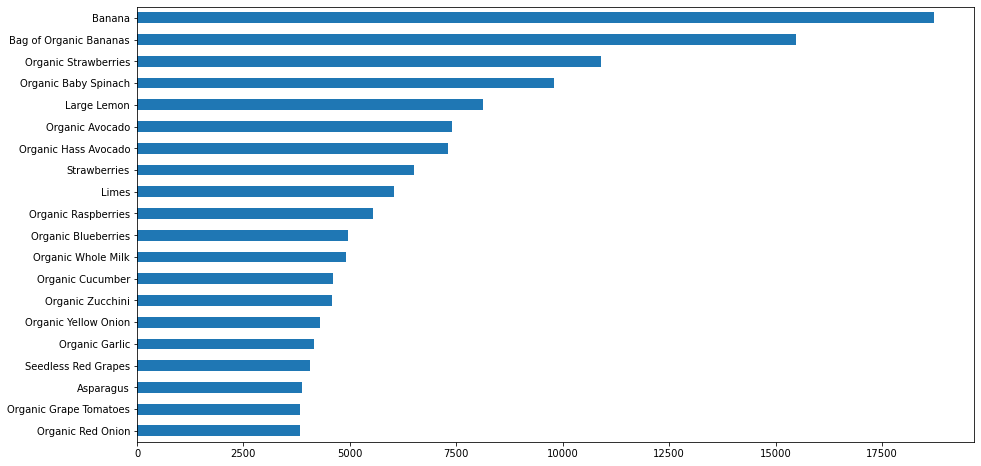

In [5]:
plt.figure(figsize=(15,8))
product_count[:20][::-1].plot.barh()
plt.show()

In [6]:
# Identify top aisle by count
aisle_count = orders_combined_df['aisle'].value_counts()
aisle_count.head(10)

fresh vegetables                 150609
fresh fruits                     150473
packaged vegetables fruits        78493
yogurt                            55240
packaged cheese                   41699
water seltzer sparkling water     36617
milk                              32644
chips pretzels                    31269
soy lactosefree                   26240
bread                             23635
Name: aisle, dtype: int64

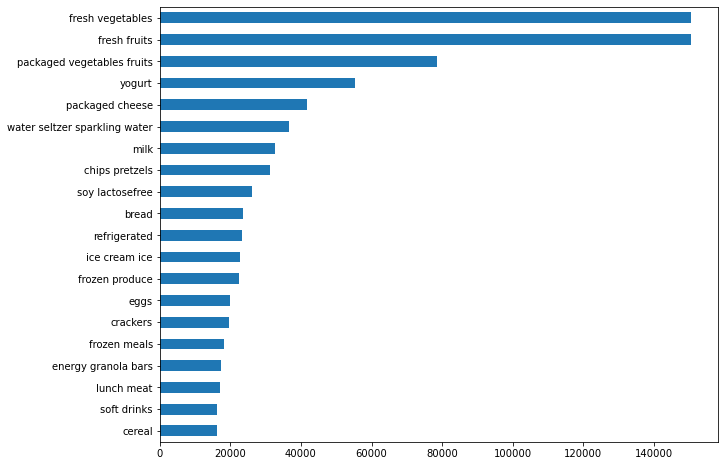

In [7]:
plt.figure(figsize=(10,8))
aisle_count[:20][::-1].plot.barh()
plt.show()

### Which are the least popular items purchased (purchased least frequently)? 
* there is a long list of product having been purchased only once, these represents about 8k or 20% the unique product purchased 
* The least popular aisles are non food related such as baby bath body care, baby accessories, beauty 

In [8]:
# Identify products with least counts - all of them pruchased only once
product_count.tail(20)

150® Cool Mint Maximum Strength Sugar Free Acid Reducer    1
Small/Medium Maximum Absorbency Women Underwear            1
100% Raw Coconut Drink                                     1
Dailyware Variety Pack                                     1
Pimiento Sliced Manzanilla Olives                          1
Yellow Easter Basket Cakes                                 1
Vitamin E Stick                                            1
Barbados Rum                                               1
Full Sheet Paper Towels                                    1
Peanut Butter Chocolate Chip Ice Cream                     1
Beef Demi-Glace                                            1
Purifying Daily Detox Scrub                                1
White Baguette                                             1
Mushroom Lo Mein Noodles                                   1
Organic Crushed Arabella Plum Tomatoes                     1
Tempranillo                                                1
Berry Weiss             

In [9]:
# compute the number and proportion of product having been purchased 1 time or less
one_time_products = len(product_count[product_count <= 1])
total_products = orders_combined_df['product_id'].nunique()
proportion_of_onetime_products = one_time_products/total_products

one_time_products, total_products, round(proportion_of_onetime_products,2)

(7884, 39123, 0.2)

In [10]:
# Identify least popular aisles by count
aisle_count.tail(10)

first aid                     539
skin care                     534
shave needs                   532
ice cream toppings            504
specialty wines champagnes    461
kitchen supplies              448
baby bath body care           328
baby accessories              306
frozen juice                  294
beauty                        287
Name: aisle, dtype: int64

### What does the distribution of the products purchased look like ?

#### Create a ranking and description to identify each product

In [11]:
# Series - percentage for products
s_percent = (orders_combined_df['product_name'].value_counts(
    normalize=True)*100)
s_percent

Banana                                  1.352432
Bag of Organic Bananas                  1.117999
Organic Strawberries                    0.786788
Organic Baby Spinach                    0.706621
Large Lemon                             0.587527
                                          ...   
Tempranillo                             0.000072
Berry Weiss                             0.000072
Cashmere                                0.000072
Unsalted Slivered California Almonds    0.000072
Organic Enchilada Red Sauce Medium      0.000072
Name: product_name, Length: 39123, dtype: float64

In [12]:
# Series - Cumulative percentage for products
s_cum_percent = (orders_combined_df['product_name'].value_counts(
    normalize=True)*100).cumsum()
s_cum_percent

Banana                                    1.352432
Bag of Organic Bananas                    2.470430
Organic Strawberries                      3.257218
Organic Baby Spinach                      3.963840
Large Lemon                               4.551367
                                           ...    
Tempranillo                              99.999711
Berry Weiss                              99.999783
Cashmere                                 99.999856
Unsalted Slivered California Almonds     99.999928
Organic Enchilada Red Sauce Medium      100.000000
Name: product_name, Length: 39123, dtype: float64

In [13]:
# Create Product Dataframe
item_frequency_df = pd.DataFrame({'Count': product_count, 'Percent': s_percent,
                                  'Cum_Percent': s_cum_percent}).reset_index().rename(columns={'index': 'Product'})
item_frequency_df

,Product,Count,Percent,Cum_Percent
0,Banana,18726,1.352432,1.352432
1,Bag of Organic Bananas,15480,1.117999,2.470430
2,Organic Strawberries,10894,0.786788,3.257218
3,Organic Baby Spinach,9784,0.706621,3.963840
4,Large Lemon,8135,0.587527,4.551367
...,...,...,...,...
39118,Tempranillo,1,0.000072,99.999711
39119,Berry Weiss,1,0.000072,99.999783
39120,Cashmere,1,0.000072,99.999856
39121,Unsalted Slivered California Almonds,1,0.000072,99.999928


In [14]:
# Add Product Rank by purchase count
item_frequency_df['rank'] = item_frequency_df['Count'].rank(
    ascending=False, method='first')
item_frequency_df

,Product,Count,Percent,Cum_Percent,rank
0,Banana,18726,1.352432,1.352432,1.0
1,Bag of Organic Bananas,15480,1.117999,2.470430,2.0
2,Organic Strawberries,10894,0.786788,3.257218,3.0
3,Organic Baby Spinach,9784,0.706621,3.963840,4.0
4,Large Lemon,8135,0.587527,4.551367,5.0
...,...,...,...,...,...
39118,Tempranillo,1,0.000072,99.999711,39119.0
39119,Berry Weiss,1,0.000072,99.999783,39120.0
39120,Cashmere,1,0.000072,99.999856,39121.0
39121,Unsalted Slivered California Almonds,1,0.000072,99.999928,39122.0


In [15]:
# Add Product Description
item_frequency_df['description'] = "rank:" + item_frequency_df['rank'].astype(int).astype(str) \
        + " " + "pct:" + round(item_frequency_df['Percent'],2).astype(str) \
        + " " + "cum_pct:" + round(item_frequency_df['Cum_Percent'],2).astype(str)
item_frequency_df

,Product,Count,Percent,Cum_Percent,rank,description
0,Banana,18726,1.352432,1.352432,1.0,rank:1 pct:1.35 cum_pct:1.35
1,Bag of Organic Bananas,15480,1.117999,2.470430,2.0,rank:2 pct:1.12 cum_pct:2.47
2,Organic Strawberries,10894,0.786788,3.257218,3.0,rank:3 pct:0.79 cum_pct:3.26
3,Organic Baby Spinach,9784,0.706621,3.963840,4.0,rank:4 pct:0.71 cum_pct:3.96
4,Large Lemon,8135,0.587527,4.551367,5.0,rank:5 pct:0.59 cum_pct:4.55
...,...,...,...,...,...,...
39118,Tempranillo,1,0.000072,99.999711,39119.0,rank:39119 pct:0.0 cum_pct:100.0
39119,Berry Weiss,1,0.000072,99.999783,39120.0,rank:39120 pct:0.0 cum_pct:100.0
39120,Cashmere,1,0.000072,99.999856,39121.0,rank:39121 pct:0.0 cum_pct:100.0
39121,Unsalted Slivered California Almonds,1,0.000072,99.999928,39122.0,rank:39122 pct:0.0 cum_pct:100.0


#### Create a visualization of the product distribution

* We can clearly see that the product purchase frequency drops significantly after the first 1000 ranked products around the 50 percentile of product count
* Organic and fresh products are by far the most popular products
* The distribution is right skewed with a long tail and a mode of 1 for product purchased count 

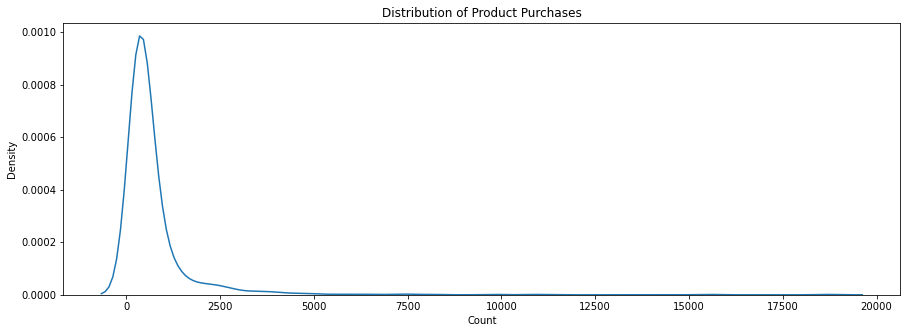

In [16]:
# compute the distribution of products by purchase frequency - top 1000
plt.figure(figsize=(15, 5))
sns.kdeplot(item_frequency_df['Count'][:1000]).set_title(
    "Distribution of Product Purchases")
plt.show()

In [17]:
# create distribution of product by purchase frequency - first 5000 only 
import plotly.express as px
fig = px.scatter(item_frequency_df[:5000], x="rank", y="Count", hover_name="Product", hover_data=[
                 "description"],  title="Top 5000 Products Ranked - Item Frequency Distribution")
fig.show()
pio.write_html(fig, file='item_frequency.html', auto_open=True)

### What does the distribution of purchase by customer look like ?

In [18]:
# Series - count user purchases
s_count = orders_combined_df['user_id'].value_counts()
# Series - percentage user purchases
s_percent = orders_combined_df['user_id'].value_counts(normalize=True)*100
# Series - cumulative percentage user purchases
s_cum_percent = (orders_combined_df['user_id'].value_counts(
    normalize=True)*100).cumsum()

# create the user purchases Dataframe
user_frequency_df = pd.DataFrame({'Count': s_count, 'Percent': s_percent,
                                  'Cum_Percent': s_cum_percent}).reset_index().rename(columns={'index': 'User'})
# Add user rank
user_frequency_df['rank'] = user_frequency_df['Count'].rank(
    ascending=False, method='first')

user_frequency_df

,User,Count,Percent,Cum_Percent,rank
0,149753,80,0.005778,0.005778,1.0
1,197541,80,0.005778,0.011556,2.0
2,63458,77,0.005561,0.017117,3.0
3,83993,76,0.005489,0.022606,4.0
4,189951,76,0.005489,0.028094,5.0
...,...,...,...,...,...
131204,125263,1,0.000072,99.999711,131205.0
131205,182309,1,0.000072,99.999783,131206.0
131206,48932,1,0.000072,99.999856,131207.0
131207,169248,1,0.000072,99.999928,131208.0


In [19]:
# Add User Description
user_frequency_df['description'] = "rank:" + user_frequency_df['rank'].astype(int).astype(str) \
    + " " +  "pct:" + round(user_frequency_df['Percent'],2).astype(str) \
    + " " + "cum_pct:" + round(user_frequency_df['Cum_Percent'],2).astype(str)
    
user_frequency_df

,User,Count,Percent,Cum_Percent,rank,description
0,149753,80,0.005778,0.005778,1.0,rank:1 pct:0.01 cum_pct:0.01
1,197541,80,0.005778,0.011556,2.0,rank:2 pct:0.01 cum_pct:0.01
2,63458,77,0.005561,0.017117,3.0,rank:3 pct:0.01 cum_pct:0.02
3,83993,76,0.005489,0.022606,4.0,rank:4 pct:0.01 cum_pct:0.02
4,189951,76,0.005489,0.028094,5.0,rank:5 pct:0.01 cum_pct:0.03
...,...,...,...,...,...,...
131204,125263,1,0.000072,99.999711,131205.0,rank:131205 pct:0.0 cum_pct:100.0
131205,182309,1,0.000072,99.999783,131206.0,rank:131206 pct:0.0 cum_pct:100.0
131206,48932,1,0.000072,99.999856,131207.0,rank:131207 pct:0.0 cum_pct:100.0
131207,169248,1,0.000072,99.999928,131208.0,rank:131208 pct:0.0 cum_pct:100.0


#### Create distribution of product by purchase frequency

* We can observe that about 4k users have purchase 30 products or more with one user having purchase 80 products
* After that threshold passed, the curve flattens quickly for the rest of the 100k+ users
* The distribution is right skewed with a long tail and a mode of 5 product purchase per user

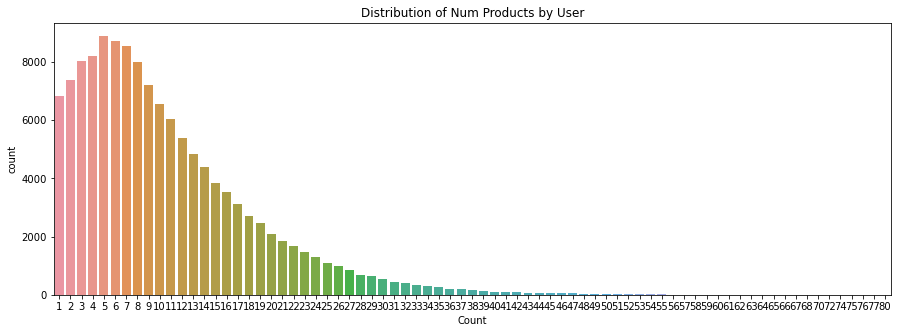

In [20]:
# compute the distribution of products purchased by User
plt.figure(figsize=(15, 5))
sns.countplot(x='Count', data=user_frequency_df).set_title(
    "Distribution of Num Products by User")
plt.show()

In [21]:
# create distribution of product by user purchase frequency - first 10000 only 
fig = px.scatter(user_frequency_df, x="rank", y="Count", hover_name="User", hover_data=[
                 "description"],  title="User Purchase Frequency Distribution")
fig.show()
pio.write_html(fig, file='user_purchase_frequency.html', auto_open=True)

In [ ]:
#import chart_studio.tools as tls
#tls.get_embed('https://github.com/ChristopherCochet/Market-Basket-Analysis/blob/main/item_frequency.html')